## Supply Chain Simulation Model (Version Simplifiée Améliorée)



Réimplémentation simplifiée de l'article:
"An Open Tool-Set for Simulation, Design-Space Exploration and 
Optimization of Supply Chains and Inventory Problems"

Simplifications apportées:
1. Réseau réduit: 1 fabricant, 2 distributeurs, 1 détaillant
2. Paramètres réduits: 4 au lieu de 8 (S_D, s_D, S_R, s_R)
3. Durée simulation: 100 jours au lieu de 1000
4. Nombre de runs: 50 au lieu de 200

Justification: Ces simplifications permettent une exécution sur PC modeste
tout en conservant la logique et les concepts clés du modèle.

Edit (01/06/2025) :  
**Version interactive**  
- Ajout d'une interface interactive permettant de charger des fichiers de données et de configurer les paramètres de simulation directement via la console ou le notebook.  
- Facilite l'expérimentation rapide et l'adaptation du modèle à différents scénarios utilisateurs.  



In [1]:


# ============================================================================
# SECTION 1: IMPORTS ET CONFIGURATION
# ============================================================================

import simpy
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from typing import List, Dict, Tuple, Optional
import time
import warnings
import os
from pathlib import Path
warnings.filterwarnings('ignore')

# Configuration matplotlib pour affichage
plt.style.use('seaborn-v0_8')
sns.set_palette("husl")


# Configuration pour reproductibilité
np.random.seed(42)

# DÉCOMMENTER ET DÉFINIR PARAMS !
PARAMS = {
    'P': 100,        # Profit par unité vendue (Rs)
    'HC_D': 1,       # Coût de stockage distributeur (Rs/unité/jour)
    'HC_R': 10,      # Coût de stockage détaillant (Rs/unité/jour)
    'OC': 1000,      # Coût de commande (Rs)
    'LAMBDA': 20,    # Demande quotidienne moyenne (réduite de 50 à 20)
    'SERVICE_TARGET': 0.95  # Objectif niveau de service
}

In [2]:

# ============================================================================
# SECTION 2: INTERFACE CONSOLE
# ============================================================================

class SupplyChainUI:
    """Interface utilisateur console pour la simulation"""
    
    def __init__(self):
        self.params_file = None
        self.data_file = None
        self.simulation_days = 100
        self.num_simulations = 50
        self.custom_params = None
        
    def print_banner(self):
        """Affiche la bannière de l'application"""
        print("=" * 60)
        print("      SUPPLY CHAIN OPTIMIZATION SIMULATOR")
        print("           Version Interactive v2.0")
        print("=" * 60)
        print()
        
    def get_file_path(self, prompt, check_exists=True):
        """Demande un chemin de fichier avec validation"""
        while True:
            path = input(prompt).strip()
            if not path:
                return None
            
            if check_exists and not os.path.exists(path):
                print(f"❌ Fichier non trouvé: {path}")
                continue
            
            return Path(path)
    
    def configure_files(self):
        """Configuration des fichiers d'entrée"""
        print("📁 CONFIGURATION DES FICHIERS D'ENTRÉE")
        print("-" * 40)
        
        # Fichier paramètres
        print("1. Fichier de paramètres (CSV avec colonnes SD1,sD1,SD2,sD2,SR1,sR1,SR2,sR2)")
        print("   Laissez vide pour utiliser les paramètres par défaut")
        self.params_file = self.get_file_path("   📂 Chemin du fichier paramètres: ", False)
        
        if self.params_file and os.path.exists(self.params_file):
            print(f"   ✅ Fichier paramètres chargé: {self.params_file}")
            # Prévisualisation
            try:
                df = pd.read_csv(self.params_file)
                print(f"   📊 {len(df)} configurations trouvées")
                print("   🔍 Aperçu:")
                print(df.head(3).to_string(index=False))
            except Exception as e:
                print(f"   ⚠️  Erreur lors de la lecture: {e}")
        else:
            print("   📝 Utilisation des paramètres par défaut")
        
        print()
        
        # Fichier données historiques (optionnel)
        print("2. Fichier de données historiques (optionnel)")
        print("   Pour comparaison avec simulations précédentes")
        self.data_file = self.get_file_path("   📂 Chemin du fichier données: ", False)
        
        if self.data_file and os.path.exists(self.data_file):
            print(f"   ✅ Fichier données chargé: {self.data_file}")
        else:
            print("   📝 Pas de données historiques")
        
        print()

    def show_auto_detected_summary(self):
        """Affiche un résumé des fichiers détectés automatiquement"""
        print("🤖 DÉTECTION AUTOMATIQUE")
        print("-" * 40)
        
        if self.params_file and os.path.exists(self.params_file):
            print(f"✅ Fichier paramètres: {os.path.basename(self.params_file)}")
            try:
                df = pd.read_csv(self.params_file)
                print(f"   📊 {len(df)} configurations")
            except:
                print("   ⚠️  Erreur de lecture")
        else:
            print("❌ Fichier paramètres: non trouvé")
        
        if self.data_file and os.path.exists(self.data_file):
            print(f"✅ Fichier données: {os.path.basename(self.data_file)}")
        else:
            print("⚠️  Fichier données: non trouvé (optionnel)")
        
        print()

    def configure_simulation_simple(self):
        """Configuration simplifiée de la simulation"""
        print("⚙️  CONFIGURATION DE LA SIMULATION")
        print("-" * 40)
        
        # Valeurs par défaut optimisées
        print(f"📅 Jours de simulation: {self.simulation_days} (recommandé: 30-100)")
        print(f"🔄 Nombre de simulations: {self.num_simulations} (recommandé: 20-100)")
        
        # Demander si l'utilisateur veut modifier
        modify = input("🔧 Modifier ces paramètres? (y/n): ").strip().lower()
        
        if modify in ['y', 'yes', 'o', 'oui']:
            self.configure_simulation()  # Utilise la méthode complète
        else:
            print("   ✅ Utilisation des paramètres par défaut")
        
        print()

    def show_quick_summary(self):
        """Affiche un résumé rapide de la configuration"""
        print("📋 CONFIGURATION RAPIDE")
        print("-" * 30)
        print(f"📅 Durée: {self.simulation_days} jours")
        print(f"🔄 Simulations: {self.num_simulations} par configuration")
        
        if self.params_file:
            try:
                df = pd.read_csv(self.params_file)
                print(f"📊 Configurations: {len(df)}")
                total_sims = len(df) * self.num_simulations
                print(f"⏱️  Total simulations: {total_sims}")
                print(f"⏱️  Temps estimé: {total_sims * self.simulation_days / 10000:.1f} min")
            except:
                print("📊 Configuration manuelle")
        
        print()
        
    def configure_files_with_default_path(self, data_folder):
        """Configuration des fichiers avec chemin par défaut"""
        print("📁 CONFIGURATION DES FICHIERS D'ENTRÉE")
        print("-" * 40)
        
        # Fichier paramètres avec suggestion
        default_params = os.path.join(data_folder, "in_params.csv")
        print("1. Fichier de paramètres (CSV avec colonnes SD1,sD1,SD2,sD2,SR1,sR1,SR2,sR2)")
        print(f"   Chemin suggéré: {default_params}")
        
        path_input = input("   📂 Chemin du fichier paramètres (Entrée pour défaut): ").strip()
        
        if not path_input:
            self.params_file = Path(default_params) if os.path.exists(default_params) else None
        else:
            self.params_file = Path(path_input) if os.path.exists(path_input) else None
        
        if self.params_file and os.path.exists(self.params_file):
            print(f"   ✅ Fichier paramètres chargé: {self.params_file}")
            try:
                df = pd.read_csv(self.params_file)
                print(f"   📊 {len(df)} configurations trouvées")
                print("   🔍 Aperçu:")
                print(df.head(3).to_string(index=False))
            except Exception as e:
                print(f"   ⚠️  Erreur lors de la lecture: {e}")
        else:
            print("   📝 Utilisation des paramètres par défaut")
        
        print()
        
        # Fichier données historiques avec suggestion
        default_data = os.path.join(data_folder, "supplychain_datav2.csv")
        print("2. Fichier de données historiques (optionnel)")
        print(f"   Chemin suggéré: {default_data}")
        
        data_input = input("   📂 Chemin du fichier données (Entrée pour défaut): ").strip()
        
        if not data_input:
            self.data_file = Path(default_data) if os.path.exists(default_data) else None
        else:
            self.data_file = Path(data_input) if os.path.exists(data_input) else None
        
        if self.data_file and os.path.exists(self.data_file):
            print(f"   ✅ Fichier données chargé: {self.data_file}")
        else:
            print("   📝 Pas de données historiques")
        
        print()
    
    def configure_simulation(self):
        """Configuration des paramètres de simulation"""
        print("⚙️  CONFIGURATION DE LA SIMULATION")
        print("-" * 40)
        
        # Nombre de jours
        while True:
            try:
                days_input = input(f"📅 Nombre de jours de simulation [{self.simulation_days}]: ").strip()
                if not days_input:
                    break
                days = int(days_input)
                if days > 0:
                    self.simulation_days = days
                    break
                else:
                    print("   ❌ Le nombre de jours doit être positif")
            except ValueError:
                print("   ❌ Veuillez entrer un nombre entier")
        
        # Nombre de simulations
        while True:
            try:
                sims_input = input(f"🔄 Nombre de simulations par configuration [{self.num_simulations}]: ").strip()
                if not sims_input:
                    break
                sims = int(sims_input)
                if sims > 0:
                    self.num_simulations = sims
                    break
                else:
                    print("   ❌ Le nombre de simulations doit être positif")
            except ValueError:
                print("   ❌ Veuillez entrer un nombre entier")
        
        # Paramètres personnalisés si pas de fichier
        if not self.params_file or not os.path.exists(self.params_file):
            print("\n🎯 Configuration manuelle des paramètres:")
            print("   Laissez vide pour utiliser les valeurs par défaut")
            
            params = {}
            param_names = {
                'S_D': ('Capacité Distributeur', 400),
                's_D': ('Seuil Distributeur', 300),
                'S_R': ('Capacité Détaillant', 200),
                's_R': ('Seuil Détaillant', 100)
            }
            
            for key, (desc, default) in param_names.items():
                while True:
                    try:
                        value_input = input(f"   📦 {desc} [{default}]: ").strip()
                        if not value_input:
                            params[key] = default
                            break
                        value = int(value_input)
                        if value > 0:
                            params[key] = value
                            break
                        else:
                            print("     ❌ La valeur doit être positive")
                    except ValueError:
                        print("     ❌ Veuillez entrer un nombre entier")
            
            self.custom_params = params
        
        print()
    
    def show_configuration_summary(self):
        """Affiche un résumé de la configuration"""
        print("📋 RÉSUMÉ DE LA CONFIGURATION")
        print("-" * 40)
        print(f"📅 Jours de simulation: {self.simulation_days}")
        print(f"🔄 Nombre de simulations: {self.num_simulations}")
        
        if self.params_file and os.path.exists(self.params_file):
            print(f"📂 Fichier paramètres: {self.params_file}")
        else:
            print(f"📦 Paramètres manuels: {self.custom_params}")
        
        if self.data_file and os.path.exists(self.data_file):
            print(f"📊 Fichier données: {self.data_file}")
        
        print()
        
    def confirm_execution(self):
        """Demande confirmation avant exécution"""
        while True:
            confirm = input("🚀 Lancer la simulation? (y/n): ").strip().lower()
            if confirm in ['y', 'yes', 'o', 'oui']:
                return True
            elif confirm in ['n', 'no', 'non']:
                return False
            else:
                print("   ❌ Veuillez répondre par y/n")


In [3]:
# ============================================================================
# SECTION 3: CLASSES DE BASE (identiques mais avec logs améliorés)
# ============================================================================

class InventoryMonitor:
    """Moniteur d'inventaire avec calcul de moyenne pondérée dans le temps"""
    def __init__(self, env, initial_level, capacity):
        self.env = env
        self.level = initial_level
        self.capacity = capacity
        self.avg_level = 0
        self.last_time = 0
        self.last_level = initial_level
        
    def update_level(self, new_level):
        """Met à jour le niveau et calcule la moyenne pondérée"""
        current_time = self.env.now
        time_delta = current_time - self.last_time
        
        if time_delta > 0:
            self.avg_level = (self.avg_level * self.last_time + 
                            self.last_level * time_delta) / current_time
        
        self.last_time = current_time
        self.last_level = new_level
        self.level = new_level

class SupplyChainNode:
    """Classe de base pour tous les acteurs de la chaîne"""
    def __init__(self, env: simpy.Environment, name: str, 
                 S: Optional[int] = None, s: Optional[int] = None,
                 H: float = 0, suppliers: List = None):
        self.env = env
        self.name = name
        self.S = S
        self.s = s
        self.H = H
        self.suppliers = suppliers or []
        
        # Métriques
        self.total_sold = 0
        self.total_ordered = 0
        self.customers_lost = 0
        self.customers_total = 0
        self.holding_costs = []
        self.delivery_costs = []
        
        # Inventaire
        if S is not None:
            self.inventory = InventoryMonitor(env, S, S)
            self.container = simpy.Container(env, capacity=S, init=S)
            self.ordered = False
            env.process(self.monitor_inventory())
            
    def monitor_inventory(self):
        """Surveillance quotidienne de l'inventaire"""
        while True:
            yield self.env.timeout(1)
            
            current_level = self.container.level
            self.inventory.update_level(current_level)
            self.holding_costs.append(current_level * self.H)
            
            if current_level < self.s and not self.ordered:
                self.env.process(self.order())
                self.ordered = True

    def order(self):
        """Logique de commande"""
        if not self.suppliers:
            return
            
        supplier = self.suppliers[0]
        quantity = self.S - self.container.level
        
        if hasattr(supplier, 'container') and quantity > 0:
            if supplier.container.level >= quantity:
                yield supplier.container.get(quantity)
                supplier.total_sold += quantity
                
                # Délai de livraison
                yield self.env.timeout(2)
                
                yield self.container.put(quantity)
                self.total_ordered += quantity
                
                # Enregistrer le coût de livraison
                self.delivery_costs.append(PARAMS['OC'])  
                
        self.ordered = False

class Manufacturer(SupplyChainNode):
    """Fabricant avec capacité illimitée"""
    def __init__(self, env, name="Manufacturer"):
        super().__init__(env, name)
        self.container = simpy.Container(env, capacity=float('inf'), 
                                       init=float('inf'))

class Distributor(SupplyChainNode):
    """Distributeur avec gestion d'inventaire"""
    def __init__(self, env, name, S, s, H=1, manufacturer=None):
        super().__init__(env, name, S, s, H, [manufacturer] if manufacturer else [])

class Retailer(SupplyChainNode):
    """Détaillant en contact avec les clients"""
    def __init__(self, env, name, S, s, H=10, distributors=None):
        super().__init__(env, name, S, s, H, distributors or [])
        self.profit_per_unit = 100


In [4]:

# ============================================================================
# SECTION 4: ACTEURS SPÉCIFIQUES
# ============================================================================

class Manufacturer(SupplyChainNode):
    """Fabricant avec capacité illimitée"""
    def __init__(self, env, name="Manufacturer"):
        super().__init__(env, name)
        # Capacité illimitée simulée
        self.container = simpy.Container(env, capacity=float('inf'), 
                                       init=float('inf'))

class Distributor(SupplyChainNode):
    """Distributeur avec gestion d'inventaire"""
    def __init__(self, env, name, S, s, H=1, manufacturer=None):
        super().__init__(env, name, S, s, H, [manufacturer] if manufacturer else [])

class Retailer(SupplyChainNode):
    """Détaillant en contact avec les clients"""
    def __init__(self, env, name, S, s, H=10, distributors=None):
        super().__init__(env, name, S, s, H, distributors or [])
        self.profit_per_unit = PARAMS['P']  


In [5]:
# ============================================================================
# SECTION 5: ANALYSE DES DONNÉES
# ============================================================================

def load_and_process_params(params_file):
    """Charge et traite le fichier de paramètres"""
    try:
        df = pd.read_csv(params_file)
        print(f"📂 Fichier paramètres chargé: {len(df)} configurations")
        
        # Vérifier les colonnes attendues
        expected_cols = ['SD1', 'sD1', 'SD2', 'sD2', 'SR1', 'sR1', 'SR2', 'sR2']
        missing_cols = set(expected_cols) - set(df.columns)
        
        if missing_cols:
            print(f"⚠️  Colonnes manquantes: {missing_cols}")
            return None
        
        # Pour cette version simplifiée, on utilise seulement SD1, sD1, SR1, sR1
        configs = []
        for _, row in df.iterrows():
            configs.append({
                'S_D': int(row['SD1']),
                's_D': int(row['sD1']),
                'S_R': int(row['SR1']),
                's_R': int(row['sR1'])
            })
        
        return configs
    
    except Exception as e:
        print(f"❌ Erreur lors du chargement: {e}")
        return None

def run_multiple_simulations(S_D, s_D, S_R, s_R, num_runs, sim_days, show_progress=False):
    """
    Exécute plusieurs simulations pour une configuration donnée
    """
    results = []
    
    for run in range(num_runs):
        try:
            # Seed pour reproductibilité
            np.random.seed(42 + run)
            
            # Créer l'environnement de simulation
            env = simpy.Environment()
            
            # Créer les acteurs
            manufacturer = Manufacturer(env, "Manufacturer")
            distributor = Distributor(env, "Distributor", S_D, s_D, 
                                    PARAMS['HC_D'], manufacturer)
            retailer = Retailer(env, "Retailer", S_R, s_R, 
                              PARAMS['HC_R'], [distributor])
            
            # Statistiques pour cette simulation
            daily_demands = []
            daily_sales = []
            daily_lost_sales = []
            
            # Processus de demande client
            def customer_demand_process():
                while True:
                    # Générer demande aléatoire (Poisson)
                    daily_demand = np.random.poisson(PARAMS['LAMBDA'])
                    daily_demands.append(daily_demand)
                    
                    # Tenter de satisfaire la demande
                    if retailer.container.level >= daily_demand:
                        yield retailer.container.get(daily_demand)
                        retailer.total_sold += daily_demand
                        retailer.customers_total += 1
                        daily_sales.append(daily_demand)
                        daily_lost_sales.append(0)
                    else:
                        # Satisfaire partiellement
                        available = int(retailer.container.level)
                        if available > 0:
                            yield retailer.container.get(available)
                            retailer.total_sold += available
                            retailer.customers_total += 1
                            retailer.customers_lost += 1
                            daily_sales.append(available)
                            daily_lost_sales.append(daily_demand - available)
                        else:
                            retailer.customers_total += 1
                            retailer.customers_lost += 1
                            daily_sales.append(0)
                            daily_lost_sales.append(daily_demand)
                    
                    # Attendre un jour
                    yield env.timeout(1)
            
            # Lancer le processus de demande
            env.process(customer_demand_process())
            
            # Exécuter la simulation
            env.run(until=sim_days)
            
            # Calculer les métriques
            total_revenue = retailer.total_sold * PARAMS['P']
            total_holding_cost = (sum(retailer.holding_costs) + 
                                sum(distributor.holding_costs))
            total_ordering_cost = (len(retailer.delivery_costs) * PARAMS['OC'] + 
                                 len(distributor.delivery_costs) * PARAMS['OC'])
            
            net_profit = total_revenue - total_holding_cost - total_ordering_cost
            net_profit_per_day = net_profit / sim_days
            
            # Calculer le niveau de service
            total_demand = sum(daily_demands) if daily_demands else 1
            total_lost = sum(daily_lost_sales) if daily_lost_sales else 0
            service_level = (total_demand - total_lost) / total_demand if total_demand > 0 else 0
            
            avg_inventory = (retailer.inventory.avg_level + distributor.inventory.avg_level) / 2
            
            results.append({
                'run': run,
                'net_profit': net_profit,
                'net_profit_per_day': net_profit_per_day,
                'service_level': service_level,
                'avg_inventory': avg_inventory,
                'total_sold': retailer.total_sold,
                'customers_lost': retailer.customers_lost,
                'total_demand': total_demand,
                'total_lost': total_lost
            })
            
            if show_progress and (run + 1) % max(1, num_runs // 10) == 0:
                print(f"   ⏳ {run + 1}/{num_runs} simulations terminées")
                
        except Exception as e:
            print(f"   ❌ Erreur simulation {run}: {e}")
            import traceback
            traceback.print_exc()
    
    # Calculer les statistiques
    df_results = pd.DataFrame(results)
    
    if len(df_results) > 0 and len(df_results[df_results['net_profit_per_day'] != 0]) > 0:
        # Filtrer les résultats valides
        df_valid = df_results[df_results['net_profit_per_day'] != 0]
        
        stats = {
            'mean': {
                'net_profit_per_day': df_valid['net_profit_per_day'].mean(),
                'service_level': df_valid['service_level'].mean(),
                'avg_inventory': df_valid['avg_inventory'].mean(),
                'total_sold': df_valid['total_sold'].mean(),
                'customers_lost': df_valid['customers_lost'].mean()
            },
            'std': {
                'net_profit_per_day': df_valid['net_profit_per_day'].std(),
                'service_level': df_valid['service_level'].std(),
                'avg_inventory': df_valid['avg_inventory'].std()
            },
            'rse': {}
        }
        
        # Calculer RSE
        for col in ['net_profit_per_day', 'service_level']:
            if stats['mean'][col] != 0:
                stats['rse'][col] = (stats['std'][col] / abs(stats['mean'][col])) * 100
            else:
                stats['rse'][col] = 0
    else:
        # Statistiques par défaut
        stats = {
            'mean': {'net_profit_per_day': 0, 'service_level': 0, 'avg_inventory': 0},
            'std': {'net_profit_per_day': 0, 'service_level': 0, 'avg_inventory': 0},
            'rse': {'net_profit_per_day': 0, 'service_level': 0}
        }
    
    return stats, df_results

def run_batch_simulations(configs, sim_days, num_sims):
    """Execute les simulations pour toutes les configurations"""
    results = []
    total_configs = len(configs)
    
    print(f"\n🚀 DÉBUT DES SIMULATIONS")
    print(f"📊 {total_configs} configurations à tester")
    print(f"📅 {sim_days} jours par simulation")
    print(f"🔄 {num_sims} simulations par configuration")
    print(f"⏱️  Temps estimé: {total_configs * num_sims * sim_days / 10000:.1f} minutes")
    print("-" * 50)
    
    overall_start = time.time()
    
    for i, config in enumerate(configs):
        print(f"\n📦 Configuration {i+1}/{total_configs}")
        print(f"   S_D={config['S_D']}, s_D={config['s_D']}, "
              f"S_R={config['S_R']}, s_R={config['s_R']}")
        
        stats, df_runs = run_multiple_simulations(
            config['S_D'], config['s_D'], 
            config['S_R'], config['s_R'],
            num_sims, sim_days, show_progress=True
        )
        
        result = {
            **config,
            'net_profit_mean': stats['mean']['net_profit_per_day'],
            'net_profit_std': stats['std']['net_profit_per_day'],
            'service_level_mean': stats['mean']['service_level'],
            'service_level_std': stats['std']['service_level'],
            'rse_profit': stats['rse']['net_profit_per_day'],
            'avg_inventory_mean': stats['mean']['avg_inventory']
        }
        
        results.append(result)
        
        # Affichage des résultats intermédiaires
        print(f"   💰 Profit: {result['net_profit_mean']:.2f} ± {result['net_profit_std']:.2f} Rs/jour")
        print(f"   🎯 Service: {result['service_level_mean']:.2%}")
        print(f"   📊 RSE: {result['rse_profit']:.1f}%")
    
    total_time = time.time() - overall_start
    print(f"\n✅ SIMULATIONS TERMINÉES en {total_time/60:.1f} minutes")
    
    return pd.DataFrame(results)


In [ ]:

# ============================================================================
# SECTION 6: VISUALISATIONS AVANCÉES
# ============================================================================

def create_comprehensive_plots(df_results, save_plots=True):
    """Crée des visualisations complètes des résultats"""
    print("\n📊 GÉNÉRATION DES GRAPHIQUES")
    print("-" * 30)
    
    # Configuration des graphiques
    plt.rcParams['figure.figsize'] = (15, 12)
    fig = plt.figure(figsize=(16, 12))
    
    # 1. Heatmap Profit Net
    ax1 = plt.subplot(2, 3, 1)
    try:
        pivot_profit = df_results.pivot_table(
            index='s_R', columns='S_R', 
            values='net_profit_mean', aggfunc='mean'
        )
        sns.heatmap(pivot_profit, annot=True, fmt='.0f', 
                   cmap='RdYlGn', ax=ax1, cbar_kws={'label': 'Rs/jour'})
        ax1.set_title('Profit Net par jour (Rs)', fontweight='bold')
    except Exception as e:
        ax1.text(0.5, 0.5, f'Erreur pivot: {str(e)}', 
                ha='center', va='center', transform=ax1.transAxes)
        ax1.set_title('Profit Net par jour (Rs)')
    
    # 2. Heatmap Niveau de Service
    ax2 = plt.subplot(2, 3, 2)
    try:
        pivot_service = df_results.pivot_table(
            index='s_D', columns='S_D', 
            values='service_level_mean', aggfunc='mean'
        )
        sns.heatmap(pivot_service, annot=True, fmt='.2f', 
                   cmap='Blues', ax=ax2, cbar_kws={'label': 'Taux'})
        ax2.set_title('Niveau de Service', fontweight='bold')
    except Exception as e:
        ax2.text(0.5, 0.5, f'Données insuffisantes', 
                ha='center', va='center', transform=ax2.transAxes)
        ax2.set_title('Niveau de Service')
    
    # 3. Scatter Plot Trade-off
    ax3 = plt.subplot(2, 3, 3)
    scatter = ax3.scatter(df_results['service_level_mean'], 
                         df_results['net_profit_mean'],
                         c=df_results['rse_profit'], 
                         cmap='viridis', alpha=0.7, s=60)
    ax3.set_xlabel('Niveau de Service')
    ax3.set_ylabel('Profit Net (Rs/jour)')
    ax3.set_title('Trade-off Service vs Profit', fontweight='bold')
    ax3.grid(True, alpha=0.3)
    plt.colorbar(scatter, ax=ax3, label='RSE (%)')
    
    # 4. Distribution des Profits
    ax4 = plt.subplot(2, 3, 4)
    ax4.hist(df_results['net_profit_mean'], bins=15, 
             alpha=0.7, color='skyblue', edgecolor='black')
    ax4.axvline(df_results['net_profit_mean'].mean(), 
               color='red', linestyle='--', label='Moyenne')
    ax4.set_xlabel('Profit Net (Rs/jour)')
    ax4.set_ylabel('Fréquence')
    ax4.set_title('Distribution des Profits', fontweight='bold')
    ax4.legend()
    ax4.grid(True, alpha=0.3)
    
    # 5. Analyse RSE
    ax5 = plt.subplot(2, 3, 5)
    ax5.hist(df_results['rse_profit'], bins=15, 
             alpha=0.7, color='lightcoral', edgecolor='black')
    ax5.axvline(10, color='green', linestyle='--', 
               label='Seuil acceptable (10%)')
    ax5.set_xlabel('RSE du Profit (%)')
    ax5.set_ylabel('Fréquence')
    ax5.set_title('Précision des Estimations', fontweight='bold')
    ax5.legend()
    ax5.grid(True, alpha=0.3)
    
    # 6. Comparaison des paramètres
    ax6 = plt.subplot(2, 3, 6)
    
    # Trouver la meilleure configuration
    best_idx = df_results['net_profit_mean'].idxmax()
    best_config = df_results.loc[best_idx]
    
    params = ['S_D', 's_D', 'S_R', 's_R']
    values = [best_config[p] for p in params]
    colors = ['#FF6B6B', '#4ECDC4', '#45B7D1', '#96CEB4']
    
    bars = ax6.bar(params, values, color=colors, alpha=0.8)
    ax6.set_title('Configuration Optimale', fontweight='bold')
    ax6.set_ylabel('Valeur')
    
    # Ajouter les valeurs sur les barres
    for bar, value in zip(bars, values):
        height = bar.get_height()
        ax6.text(bar.get_x() + bar.get_width()/2., height + height*0.01,
                f'{int(value)}', ha='center', va='bottom', fontweight='bold')
    
    plt.tight_layout()
    
    if save_plots:
        timestamp = time.strftime("%Y%m%d_%H%M%S")
        filename = f'supply_chain_results_{timestamp}.png'
        plt.savefig(filename, dpi=300, bbox_inches='tight')
        print(f"💾 Graphiques sauvegardés: {filename}")
    
    plt.show()
    
    return best_config

def print_results_summary(df_results, best_config):
    """Affiche un résumé détaillé des résultats"""
    print("\n" + "="*60)
    print("                    RÉSUMÉ DES RÉSULTATS")
    print("="*60)
    
    print(f"\n📊 STATISTIQUES GÉNÉRALES")
    print(f"   Configurations testées: {len(df_results)}")
    print(f"   Profit moyen: {df_results['net_profit_mean'].mean():.2f} Rs/jour")
    print(f"   Profit médian: {df_results['net_profit_mean'].median():.2f} Rs/jour")
    print(f"   Écart-type: {df_results['net_profit_mean'].std():.2f} Rs/jour")
    print(f"   Service moyen: {df_results['service_level_mean'].mean():.2%}")
    
    print(f"\n🏆 MEILLEURE CONFIGURATION")
    print(f"   S_D (Capacité Distributeur): {int(best_config['S_D'])}")
    print(f"   s_D (Seuil Distributeur): {int(best_config['s_D'])}")
    print(f"   S_R (Capacité Détaillant): {int(best_config['S_R'])}")
    print(f"   s_R (Seuil Détaillant): {int(best_config['s_R'])}")
    print(f"   💰 Profit: {best_config['net_profit_mean']:.2f} Rs/jour")
    print(f"   🎯 Service: {best_config['service_level_mean']:.2%}")
    print(f"   📊 RSE: {best_config['rse_profit']:.1f}%")
    
    # Top 5 configurations
    print(f"\n🥇 TOP 5 CONFIGURATIONS")
    top5 = df_results.nlargest(5, 'net_profit_mean')
    for i, (_, row) in enumerate(top5.iterrows(), 1):
        print(f"   {i}. S_D={int(row['S_D'])}, s_D={int(row['s_D'])}, "
              f"S_R={int(row['S_R'])}, s_R={int(row['s_R'])} "
              f"→ {row['net_profit_mean']:.2f} Rs/jour ({row['service_level_mean']:.1%})")
    
    print("\n" + "="*60)


In [7]:
# ============================================================================
# SECTION 7: FONCTION PRINCIPALE (VERSION JUPYTER)
# ============================================================================
def main():
    """Fonction principale avec interface interactive et détection automatique des fichiers"""
    # Interface utilisateur
    ui = SupplyChainUI()
    ui.print_banner()
    
    # Détection automatique du dossier data (compatible Jupyter)
    try:
        # Essayer d'abord __file__ (scripts normaux)
        script_dir = os.path.dirname(os.path.abspath(__file__))
    except NameError:
        # Fallback pour Jupyter notebooks
        script_dir = os.getcwd()  # Utiliser le répertoire de travail courant
    
    data_folder = os.path.join(script_dir, "data")
    
    print(f"📁 Dossier de travail: {script_dir}")
    print(f"📁 Dossier data détecté: {data_folder}")
    
    # Vérifier si le dossier data existe
    if os.path.exists(data_folder):
        print(f"✅ Dossier data trouvé!")
        
        # Chercher automatiquement les fichiers
        params_file = os.path.join(data_folder, "in_params.csv")
        data_file = os.path.join(data_folder, "supplychain_datav2.csv")
        
        print(f"🔍 Recherche de fichiers dans {data_folder}:")
        
        # Fichier paramètres
        if os.path.exists(params_file):
            print(f"   ✅ in_params.csv trouvé")
            ui.params_file = Path(params_file)
            try:
                df_params = pd.read_csv(params_file)
                print(f"   📊 {len(df_params)} configurations chargées")
                print("   🔍 Aperçu des paramètres:")
                print("   " + df_params.head(3).to_string(index=False).replace('\n', '\n   '))
            except Exception as e:
                print(f"   ⚠️  Erreur lecture paramètres: {e}")
                ui.params_file = None
        else:
            print(f"   ❌ in_params.csv non trouvé")
            ui.params_file = None
        
        # Fichier données historiques
        if os.path.exists(data_file):
            print(f"   ✅ supplychain_datav2.csv trouvé")
            ui.data_file = Path(data_file)
        else:
            print(f"   ⚠️  supplychain_datav2.csv non trouvé (optionnel)")
            ui.data_file = None
        
        print()
        
        # Demander confirmation ou modification
        use_auto = input("🤖 Utiliser les fichiers détectés automatiquement? (y/n): ").strip().lower()
        if use_auto not in ['y', 'yes', 'o', 'oui']:
            print("📝 Configuration manuelle:")
            ui.configure_files()
    else:
        print(f"❌ Dossier data non trouvé: {data_folder}")
        print("📝 Configuration manuelle requise:")
        ui.configure_files()
    
    # Configuration de la simulation
    ui.configure_simulation()
    ui.show_configuration_summary()
    
    if not ui.confirm_execution():
        print("❌ Simulation annulée")
        return
    
    # Chargement des configurations
    if ui.params_file and os.path.exists(ui.params_file):
        configs = load_and_process_params(ui.params_file)
        if not configs:
            print("❌ Impossible de charger les paramètres")
            return
    else:
        # Configuration manuelle unique
        if ui.custom_params:
            configs = [ui.custom_params]
        else:
            print("❌ Aucune configuration disponible")
            return
    
    # Exécution des simulations
    try:
        df_results = run_batch_simulations(configs, ui.simulation_days, ui.num_simulations)
        
        if df_results.empty:
            print("❌ Aucun résultat généré")
            return
        
        # Affichage des résultats et graphiques
        best_config = create_comprehensive_plots(df_results)
        print_results_summary(df_results, best_config)
        
        # Sauvegarde optionnelle
        save_results = input("\n💾 Sauvegarder les résultats en CSV? (y/n): ").strip().lower()
        if save_results in ['y', 'yes', 'o', 'oui']:
            timestamp = time.strftime("%Y%m%d_%H%M%S")
            
            # Sauvegarder dans le dossier data s'il existe, sinon dans le dossier courant
            if os.path.exists(data_folder):
                filename = os.path.join(data_folder, f'supply_chain_results_{timestamp}.csv')
            else:
                filename = f'supply_chain_results_{timestamp}.csv'
            
            df_results.to_csv(filename, index=False)
            print(f"💾 Résultats sauvegardés: {filename}")
        
        # Sauvegarde des graphiques
        save_plots = input("📊 Sauvegarder les graphiques? (y/n): ").strip().lower()
        if save_plots in ['y', 'yes', 'o', 'oui']:
            timestamp = time.strftime("%Y%m%d_%H%M%S")
            
            if os.path.exists(data_folder):
                plot_filename = os.path.join(data_folder, f'supply_chain_plots_{timestamp}.png')
            else:
                plot_filename = f'supply_chain_plots_{timestamp}.png'
            
            plt.savefig(plot_filename, dpi=300, bbox_inches='tight')
            print(f"📊 Graphiques sauvegardés: {plot_filename}")
        
        print("\n🎉 Simulation terminée avec succès!")
        
    except KeyboardInterrupt:
        print("\n❌ Simulation interrompue par l'utilisateur")
    except Exception as e:
        print(f"❌ Erreur lors de l'exécution: {e}")
        import traceback
        print("📋 Détails de l'erreur:")
        traceback.print_exc()
        print("❌ Simulation annulée")

# Fonction utilitaire pour lister les fichiers du dossier data (compatible Jupyter)
def list_data_files():
    """Liste tous les fichiers dans le dossier data"""
    try:
        script_dir = os.path.dirname(os.path.abspath(__file__))
    except NameError:
        script_dir = os.getcwd()
    
    data_folder = os.path.join(script_dir, "data")
    
    print(f"📁 Contenu du dossier data ({data_folder}):")
    
    if not os.path.exists(data_folder):
        print("   ❌ Dossier data non trouvé")
        return
    
    files = os.listdir(data_folder)
    if not files:
        print("   📂 Dossier vide")
        return
    
    for file in sorted(files):
        file_path = os.path.join(data_folder, file)
        if os.path.isfile(file_path):
            size = os.path.getsize(file_path)
            print(f"   📄 {file} ({size} bytes)")
        else:
            print(f"   📁 {file}/ (dossier)")

# Version pour Jupyter - appel direct
def run_simulation():
    """Fonction wrapper pour lancer la simulation dans Jupyter"""
    main()

# Version pour vérifier les fichiers
def check_data_files():
    """Fonction wrapper pour vérifier les fichiers dans Jupyter"""
    list_data_files()

# Instructions d'utilisation dans Jupyter
print("🔧 Fonctions disponibles dans Jupyter:")
print("   • run_simulation() - Lance la simulation complète")
print("   • check_data_files() - Vérifie les fichiers dans le dossier data")
print("   • main() - Lance la fonction principale (équivalent à run_simulation)")

🔧 Fonctions disponibles dans Jupyter:
   • run_simulation() - Lance la simulation complète
   • check_data_files() - Vérifie les fichiers dans le dossier data
   • main() - Lance la fonction principale (équivalent à run_simulation)


      SUPPLY CHAIN OPTIMIZATION SIMULATOR
           Version Interactive v2.0

📁 Dossier de travail: c:\Users\alaac\Desktop\Dossier_codes\UQAC\Ete\UQAC-Discrete_event_simulation_models_for_supply_chain-Atelier2\Reimplementation\Model
📁 Dossier data détecté: c:\Users\alaac\Desktop\Dossier_codes\UQAC\Ete\UQAC-Discrete_event_simulation_models_for_supply_chain-Atelier2\Reimplementation\Model\data
✅ Dossier data trouvé!
🔍 Recherche de fichiers dans c:\Users\alaac\Desktop\Dossier_codes\UQAC\Ete\UQAC-Discrete_event_simulation_models_for_supply_chain-Atelier2\Reimplementation\Model\data:
   ✅ in_params.csv trouvé
   📊 65536 configurations chargées
   🔍 Aperçu des paramètres:
    SD1  sD1  SD2  sD2  SR1  sR1  SR2  sR2
    600  350  600  350  300  100  300  100
    600  350  600  350  300  100  300  150
    600  350  600  350  300  100  300  200
   ✅ supplychain_datav2.csv trouvé

⚙️  CONFIGURATION DE LA SIMULATION
----------------------------------------

📋 RÉSUMÉ DE LA CONFIGURATION
----------

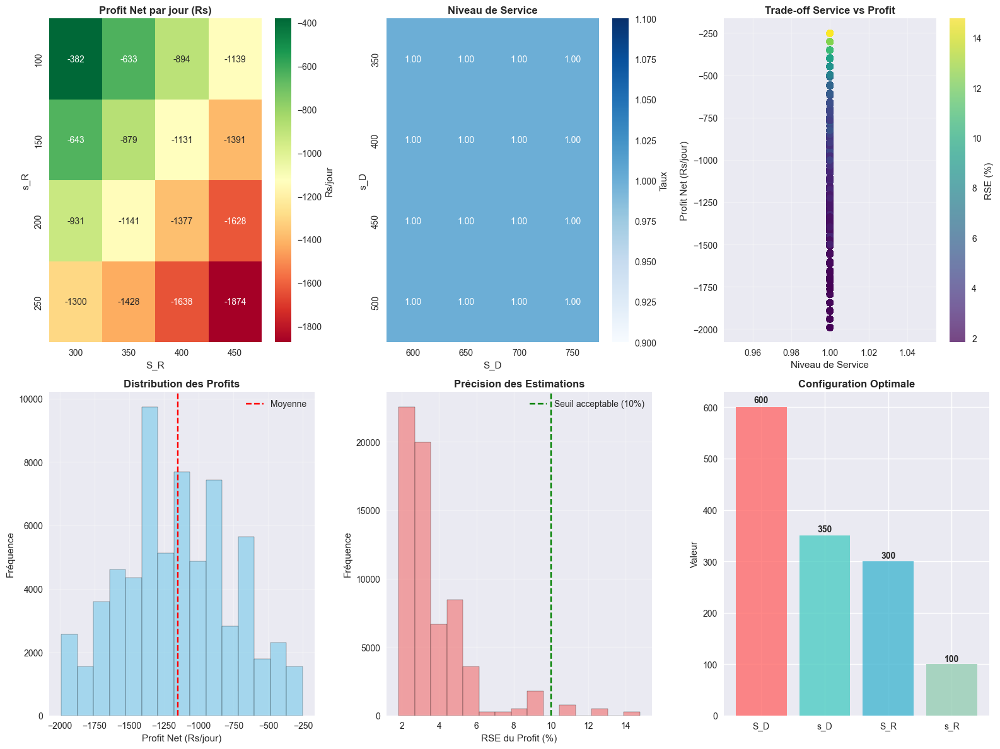


                    RÉSUMÉ DES RÉSULTATS

📊 STATISTIQUES GÉNÉRALES
   Configurations testées: 65536
   Profit moyen: -1150.59 Rs/jour
   Profit médian: -1165.89 Rs/jour
   Écart-type: 399.93 Rs/jour
   Service moyen: 100.00%

🏆 MEILLEURE CONFIGURATION
   S_D (Capacité Distributeur): 600
   s_D (Seuil Distributeur): 350
   S_R (Capacité Détaillant): 300
   s_R (Seuil Détaillant): 100
   💰 Profit: -252.16 Rs/jour
   🎯 Service: 100.00%
   📊 RSE: 14.8%

🥇 TOP 5 CONFIGURATIONS
   1. S_D=600, s_D=350, S_R=300, s_R=100 → -252.16 Rs/jour (100.0%)
   2. S_D=600, s_D=350, S_R=300, s_R=100 → -252.16 Rs/jour (100.0%)
   3. S_D=600, s_D=350, S_R=300, s_R=100 → -252.16 Rs/jour (100.0%)
   4. S_D=600, s_D=350, S_R=300, s_R=100 → -252.16 Rs/jour (100.0%)
   5. S_D=600, s_D=350, S_R=300, s_R=100 → -252.16 Rs/jour (100.0%)

💾 Résultats sauvegardés: c:\Users\alaac\Desktop\Dossier_codes\UQAC\Ete\UQAC-Discrete_event_simulation_models_for_supply_chain-Atelier2\Reimplementation\Model\data\supply_chain_resul

<Figure size 1500x1200 with 0 Axes>

In [8]:
# main
if __name__ == "__main__":
    main()
    